In [ ]:
from IPython.display import Image
from IPython.core.display import HTML

Image(url= "https://external-preview.redd.it/gaHxSLLOVycP96V_HjjBhPxqJT9xypjVvfqtla6pb_M.jpg?auto=webp&s=8c45721bfc78b760bb1c86fcbeba87cfc208b94d")


# King County Housing Data Set Project

The notebook exlpores the King County Housing market.  

The stakeholder is part of the Italian Mafia and wants to sell his/her luxury properties in the city, as the FBI is after them. After selling their houses they want to purchase new houses described as "average houses in average neighbourhoods" (i.e. to blend in) to accomodate their people without the FBI being suspicious.

## Table to contents
1. Setting up
2. Understanding Data
3. Location and Maps
4. Current houses the stakeholder owns
5. Average potential houses for the stakeholder

## Setting up

In [2]:
import pandas as pd # Pandas is an easy-to-use data structures and data analysis tools
pd.set_option('display.max_columns', None) # To display all columns

import matplotlib.pyplot as plt # Matplotlib is a python 2D plotting library
%matplotlib inline 
# A magic command that tells matplotlib to render figures as static images in the Notebook.

import seaborn as sns # Seaborn is a visualization library based on matplotlib (attractive statistical graphics).
sns.set_style('whitegrid') # One of the five seaborn themes
import warnings
warnings.filterwarnings('ignore') # To ignore some of seaborn warning msg

from scipy import stats, linalg

import folium # for map visualization
from folium import plugins

### Load data set

In [3]:
king_county_house = pd.read_csv("data/King_County_House_prices_dataset.csv", delimiter=",")

Also adjusted datatypes, to once that make more sense

In [4]:
king_county_house['waterfront'] = king_county_house['waterfront'].astype('category')
king_county_house['view'] = king_county_house['view'].astype('category')
king_county_house['condition'] = king_county_house['condition'].astype('category')
king_county_house['grade'] = king_county_house['grade'].astype('category')

In [5]:
king_county_house["month"]=pd.DatetimeIndex(king_county_house["date"]).month

## Understanding the data

In [6]:
king_county_house.head(2)

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,month
0,7129300520,10/13/2014,221900.0,3,1.00,1180,5650,1.0,NaN,0.0,3,7,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650,10
1,6414100192,12/9/2014,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,3,7,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639,12


In [7]:
king_county_house.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 22 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   id             21597 non-null  int64   
 1   date           21597 non-null  object  
 2   price          21597 non-null  float64 
 3   bedrooms       21597 non-null  int64   
 4   bathrooms      21597 non-null  float64 
 5   sqft_living    21597 non-null  int64   
 6   sqft_lot       21597 non-null  int64   
 7   floors         21597 non-null  float64 
 8   waterfront     19221 non-null  category
 9   view           21534 non-null  category
 10  condition      21597 non-null  category
 11  grade          21597 non-null  category
 12  sqft_above     21597 non-null  int64   
 13  sqft_basement  21597 non-null  object  
 14  yr_built       21597 non-null  int64   
 15  yr_renovated   17755 non-null  float64 
 16  zipcode        21597 non-null  int64   
 17  lat            21597 non-null  

### Descriptive statistics

In [8]:
king_county_house.shape

(21597, 22)

In [9]:
king_county_house.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,month
count,2.159700e+04,2.159700e+04,21597.000000,21597.000000,21597.000000,2.159700e+04,21597.000000,21597.000000,21597.000000,17755.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000
mean,4.580474e+09,5.402966e+05,3.373200,2.115826,2080.321850,1.509941e+04,1.494096,1788.596842,1970.999676,83.636778,98077.951845,47.560093,-122.213982,1986.620318,12758.283512,6.573969
std,2.876736e+09,3.673681e+05,0.926299,0.768984,918.106125,4.141264e+04,0.539683,827.759761,29.375234,399.946414,53.513072,0.138552,0.140724,685.230472,27274.441950,3.115061
min,1.000102e+06,7.800000e+04,1.000000,0.500000,370.000000,5.200000e+02,1.000000,370.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000,1.000000
25%,2.123049e+09,3.220000e+05,3.000000,1.750000,1430.000000,5.040000e+03,1.000000,1190.000000,1951.000000,0.000000,98033.000000,47.471100,-122.328000,1490.000000,5100.000000,4.000000
50%,3.904930e+09,4.500000e+05,3.000000,2.250000,1910.000000,7.618000e+03,1.500000,1560.000000,1975.000000,0.000000,98065.000000,47.571800,-122.231000,1840.000000,7620.000000,6.000000
75%,7.308900e+09,6.450000e+05,4.000000,2.500000,2550.000000,1.068500e+04,2.000000,2210.000000,1997.000000,0.000000,98118.000000,47.678000,-122.125000,2360.000000,10083.000000,9.000000
max,9.900000e+09,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,9410.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000,12.000000


## Maps and Location

<AxesSubplot:xlabel='long', ylabel='lat'>

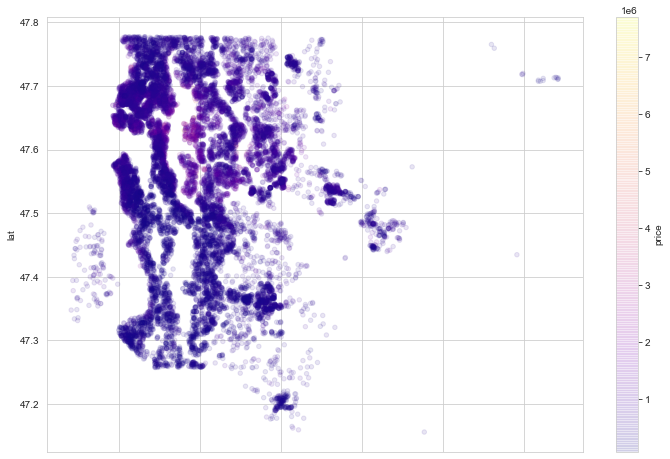

In [10]:
king_county_house.plot(kind="scatter", x="long", y="lat", alpha=0.1, c="price", cmap=plt.get_cmap("plasma"),colorbar=True, figsize=(12,8))

In [11]:
all_houses_map = folium.Map(location = [king_county_house['lat'].mean(), king_county_house['long'].mean()], zoom_start = 10)
marker_cluster = folium.plugins.MarkerCluster().add_to(all_houses_map)
MAX_RECORDS = 100
for name, row in king_county_house.iterrows():
    folium.Marker([row["lat"], row["long"]], 
                  popup="Sold for {0}$ on: {1}. Features: {2} sqft, {3} bedrooms, {4} bathrooms, year built: {5}"\
                  .format(row["price"], row["date"], row['sqft_living'], 
                          row['bedrooms'], row['bathrooms'], row['yr_built'])).add_to(marker_cluster)
    
all_houses_map

In [12]:
# Same as heatmap
#houses_heatmap = folium.Map(location = [king_county_house['lat'].mean(), king_county_house['long'].mean()], zoom_start = 9)
#houses_heatmap.add_children(plugins.HeatMap([[row["lat"], row["long"]] for name, row in king_county_house.iterrows()]))
#houses_heatmap

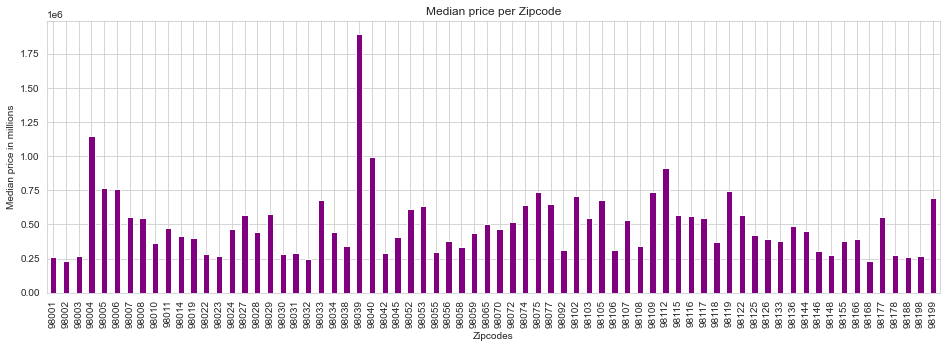

In [13]:
king_county_house.groupby("zipcode").price.median("price").plot(kind="bar", figsize=(16,5), color = "purple", xlabel="Zipcodes", ylabel= "Median price in millions", title="Median price per Zipcode");

As the figure above shows, there are clear differences in average prize between the different zipcodes, which suggests that location had an influence on the price, which was to be expected. 

## Current houses the stakeholder owns

The stakeholder said that the currently owned 10% of the most luxurious properties in the city centre of Seatle.   Therefore, the first step is to determine which properties are located in the city centre. To do this I am going to look at the zipcodes.

In [14]:
king_county_house.zipcode.unique()

array([98178, 98125, 98028, 98136, 98074, 98053, 98003, 98198, 98146,
       98038, 98007, 98115, 98107, 98126, 98019, 98103, 98002, 98133,
       98040, 98092, 98030, 98119, 98112, 98052, 98027, 98117, 98058,
       98001, 98056, 98166, 98023, 98070, 98148, 98105, 98042, 98008,
       98059, 98122, 98144, 98004, 98005, 98034, 98075, 98116, 98010,
       98118, 98199, 98032, 98045, 98102, 98077, 98108, 98168, 98177,
       98065, 98029, 98006, 98109, 98022, 98033, 98155, 98024, 98011,
       98031, 98106, 98072, 98188, 98014, 98055, 98039])

The zip codes in downtown Seattle are: 98121, 98101, 98154 and 98104, as the properties in downtown Seattle do not seem to be included in this data set, I am going to include the closest zip codes: 98109, 98102, 98122 and 98144 to look at what the stakeholder can get by selling his current properties in this area.

In [15]:
KCG_centre = king_county_house.query("zipcode ==  98109 or zipcode == 98102 or zipcode ==98122 or zipcode == 98144")

For this I am going to define a luxuary property anything that costs more than 1 million. There are 103 properties that fulfil this requirement.

In [16]:
KCG_centre_lux = KCG_centre.query("price > 1000000")

In [17]:
KCG_centre_lux.sort_values(by=['price'], ascending = False).count()["id"]

103

In [18]:
KCG_centre_lux.sort_values(by=['price'], ascending = False).head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,month
7245,6762700020,10/13/2014,7700000.0,6,8.00,12050,27600,2.5,0.0,3.0,4,13,8570,3480.0,1910,1987.0,98102,47.6298,-122.323,3940,8800,10
2862,4114601570,11/18/2014,3600000.0,3,3.25,5020,12431,2.0,1.0,4.0,3,10,3420,1600.0,1941,2002.0,98144,47.5925,-122.287,3680,12620,11
7184,7159200005,5/7/2014,3200000.0,7,4.50,6210,8856,2.5,0.0,2.0,5,11,4760,1450.0,1910,0.0,98109,47.6307,-122.354,2940,5400,5
7926,7159200040,9/17/2014,2900000.0,4,3.25,4580,4838,2.0,NaN,3.0,4,11,3080,1500.0,1991,0.0,98109,47.6305,-122.354,3540,6483,9
5961,5249800010,12/3/2014,2730000.0,4,4.25,6410,43838,2.5,0.0,2.0,4,12,5610,800.0,1906,0.0,98144,47.5703,-122.280,2270,6630,12


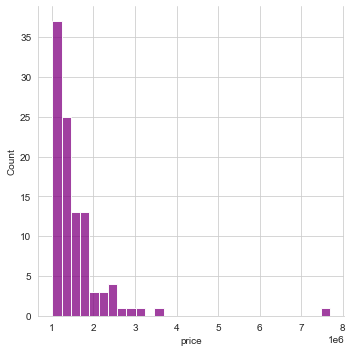

In [19]:
sns.displot(data=KCG_centre_lux, x="price", palette = "muted", color = "purple");

As we can see, there is only one property that cost over 4 million, therefore we are going to exclude the property that cost 7.7 million as it is very unlikely that, either the price named for this property is correct, and even if it is, it is unlikely the stakeholder also own a property that could be sold for that amount.

In [20]:
KCG_centre_lux.query("price > 7000000").index

Int64Index([7245], dtype='int64')

In [21]:
KCG_centre_lux=KCG_centre_lux.drop(7245)

In [22]:
KCG_centre.query("price > 1000000").median()["price"]

1380000.0

The overall average price for the luxury/most expensive properties in down town Seattle is 1,380,000.

If the stakeholder owns 10% of the luxuary properties he owns 10 properties.

### Influence of the month sold in on the price of the houses

Next, I am going to look at whether there are certain months were houses sold for a higher price, so that the stakeholder can sell the houses at the right time, to maximise his revenue on the houses. 

In [23]:
KCG_centre_lux.groupby("month").price.median()

month
1     1540000.0
2     1330000.0
3     1750000.0
4     1270000.0
5     1265000.0
6     1360000.0
7     1600000.0
8     1450000.0
9     1250000.0
10    1385000.0
11    1445000.0
12    1640000.0
Name: price, dtype: float64

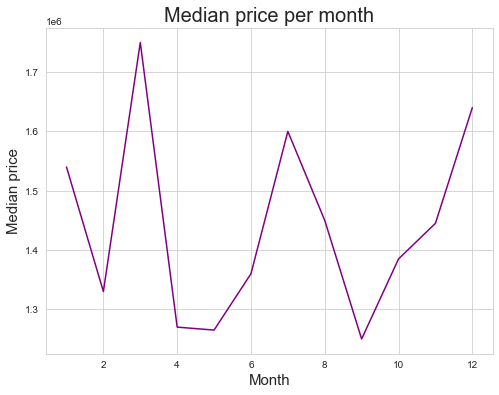

In [24]:
plt.figure(figsize=(8,6))
plt.title("Median price per month", fontsize=20)
plt.xlabel("Month", fontsize=15)
plt.ylabel("Median price", fontsize=15)
KCG_centre_lux.groupby("month").price.median().plot(color="purple", xlabel="Month", ylabel="Median price");


Above you can see that the houses that were sold in March, were sold for the highest average price, while the ones sold in September were sold for the lowest average price.

I would advice the stakeholder to sell his house in March as the prices are the highest. If this is not possible, other months with higher selling prices are: July and December.

If the stakeholder is able to sell all of this properties in March, it would mean that he would make an income of 17.5 million. However this is very unlikely.  
Even if he would be able to seel 4 of the properties in March, then wait for the next best period to sell, sell 3 in July and 3 in December he would make an income of 16.72 million. In the case of the stakeholder, this is also a better option as it would be less likel to catch the attention of the FBI.

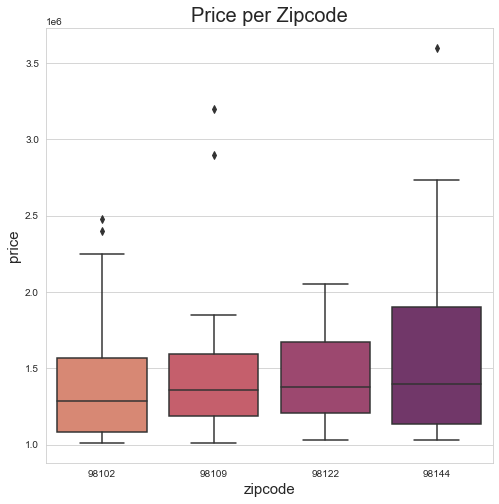

In [25]:
plt.figure(figsize=(8,8))
plt.title("Price per Zipcode", fontsize=20)
plt.xlabel("Zipcode", fontsize=15)
plt.ylabel("Price", fontsize=15)
sns.boxplot(  y="price", x="zipcode" , data=KCG_centre_lux,  orient='v', palette="flare");


A further thing would be to remeber that the exact location of the properties the stakeholder owns will have an influence on how much they will be able to sell them for. Even the four different zip codes in the city centre vary slightly by average price.

However, one should also keep in mind that there will be more things influencing the price of the houses, such as the number of bathrooms at the living area. If more details on the exact propeties of the stakeholder would have been shared a better estimate regarding the total income through selling the houses could have been made.

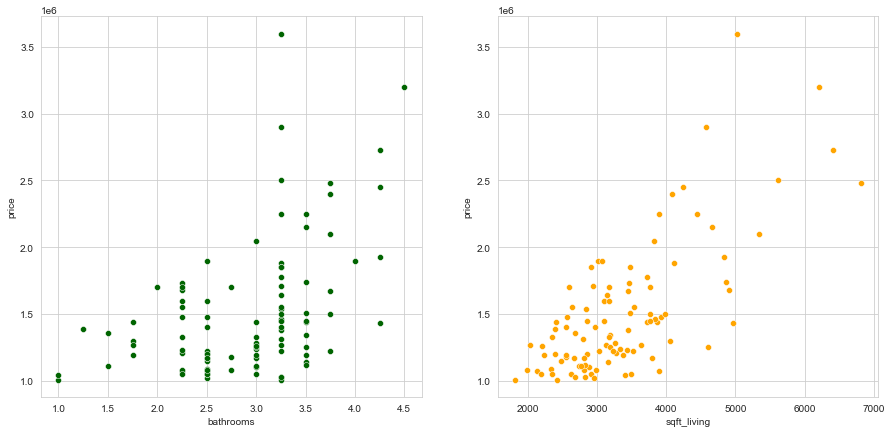

In [26]:
f, axes = plt.subplots(1,2, figsize=(15,7))
sns.scatterplot (y="price", x="bathrooms", data=KCG_centre_lux, ax=axes[0], color ="darkgreen")
sns.scatterplot (y="price", x="sqft_living", data=KCG_centre_lux, ax=axes[1], color="orange")
plt.show()

## New houses the stakeholder could invest in

The stakeholder wants to use the income generated through selling his luxurious properties to purchase "average houses in average neighbourhoods". They would ideally want to purchase more houses than sold. The income generated through the selling of their old houses was 16.72 million.

### What is an average house?

In [27]:
king_county_house_average = king_county_house.query("price < 1200000 and bedrooms <7 and bathrooms < 5 and sqft_living < 4500")

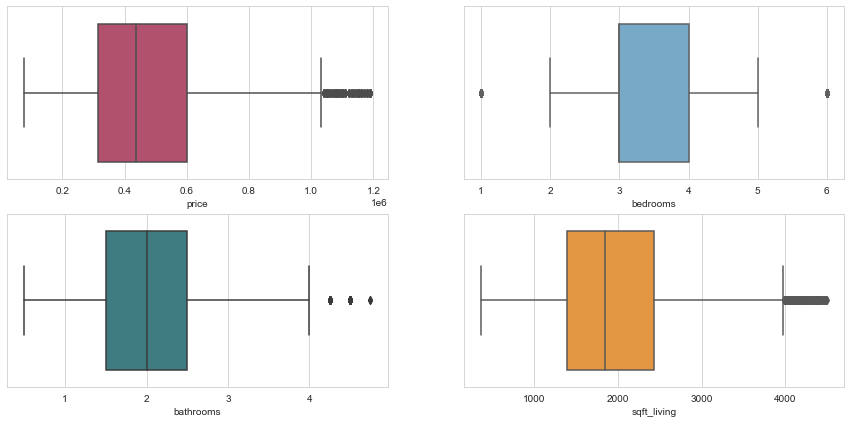

In [28]:
f, axes = plt.subplots(2,2, figsize=(15,7))

sns.boxplot(data=king_county_house_average, x="price", palette = "flare", ax=axes[0,0]);
sns.boxplot(data=king_county_house_average, x="bedrooms", palette = "Blues", ax=axes[0,1]);
sns.boxplot(data=king_county_house_average, x="bathrooms", palette = "crest", ax=axes[1,0]);
sns.boxplot(data=king_county_house_average, x="sqft_living", palette = "YlOrBr", ax=axes[1,1]);



In [29]:
king_county_house_average.median()["price"]

437500.0

The median price for a house in King County is 439,950 dollars. To look at a price range we are going to consider the price range of 350,000 to 600,000 as average prices.  
Average houses seem to have 3 or 4 bedrooms, between 1.5 and 2.5 bathrooms and a living area between 1500 and 2500 square feet.


In [30]:
king_county_house_average.query("price >= 350000 and price <= 600000 and bedrooms >= 3 and bedrooms <= 4 \
                                and bathrooms >= 1.5 and bathrooms <= 2.5 and \
                                sqft_living >= 1500 and sqft_living <= 2500").count()["id"]

3532

There are 3532 houses that would fulfil these criteria. For the median price the stakeholder would be able to purchase 39 houses. This is definitely more than the 10 houses they are selling. As it is very unlikely that they require a 39 houses to hide all the people, selling the luxurious properties and buying "average" houses would allow them to make profit.

### Where are these "average" houses located?

As the stakeholder wanted these houses to be in "average" areas, the next step is to look at which zipcodes can be considered "average". To determine this we are going to consider average areas, areas in which the median price of a house is close to the overall median price. Therefore the median price should be close to 439,950 dollars.

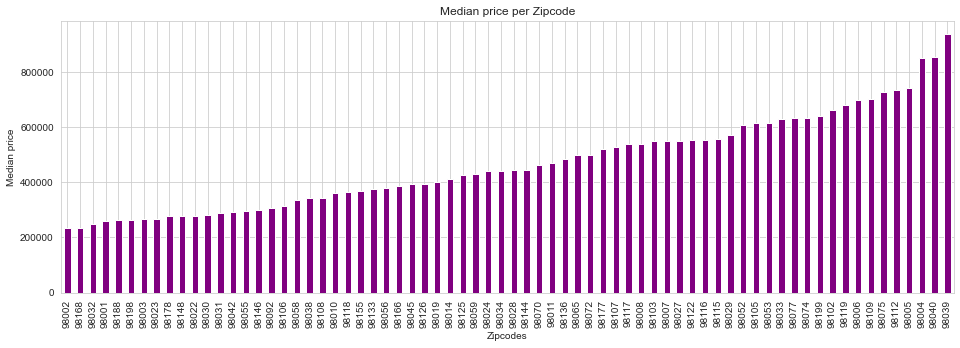

In [31]:
king_county_house_average.groupby("zipcode").price.median("price").sort_values().plot(kind="bar", figsize=(16,5), color = "purple", xlabel="Zipcodes", ylabel= "Median price", title="Median price per Zipcode");

The areas that have a median price of about 439,950 dollars, which we will consider anything between 400,000 and 480,000 dollars are:

In [32]:
kch_zip_avergage = king_county_house_average.query("zipcode == 98019 or zipcode ==98014 or zipcode ==98125 or zipcode ==98059 or zipcode ==98024 or zipcode ==98034 or zipcode ==98028 or zipcode ==98144 or zipcode ==98070 or zipcode ==98011")

In [33]:
kch_zip_avergage.groupby("zipcode").price.median("price").sort_values()

zipcode
98019    400000.0
98014    410250.0
98125    424500.0
98059    429000.0
98024    439950.0
98034    441250.0
98028    442500.0
98144    445000.0
98070    462500.0
98011    470000.0
Name: price, dtype: float64

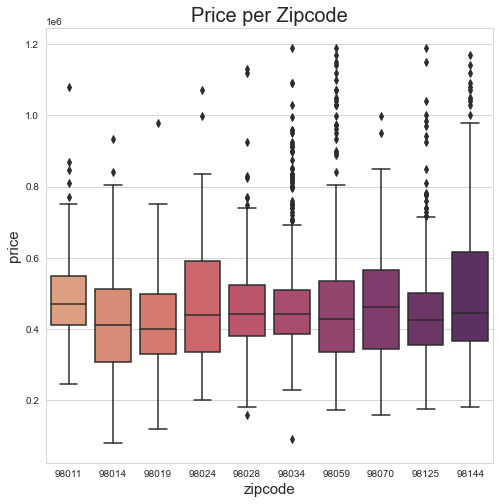

In [34]:
plt.figure(figsize=(8,8))
plt.title("Price per Zipcode", fontsize=20)
plt.xlabel("Zipcode", fontsize=15)
plt.ylabel("Price", fontsize=15)
sns.boxplot(  y="price", x="zipcode" , data=kch_zip_avergage,  orient='v', palette="flare");

In [35]:
kch_avergage_house_zip = kch_zip_avergage.query("price >= 350000 and price <= 600000 and bedrooms >= 3 and bedrooms <= 4 \
                                and bathrooms >= 1.5 and bathrooms <= 2.5 and \
                                sqft_living >= 1500 and sqft_living <= 2500")

In [36]:
kch_avergage_house_zip.count()["id"]

772

There are 772 "average" houses (as defined above), in "average neighbourhoods", so there are a lot to choose from for the stakeholder.

In [37]:
average_houses_map = folium.Map(location = [kch_avergage_house_zip['lat'].mean(), kch_avergage_house_zip['long'].mean()], zoom_start = 10)
marker_cluster = folium.plugins.MarkerCluster().add_to(average_houses_map)
MAX_RECORDS = 100
for name, row in kch_avergage_house_zip.iterrows():
    folium.Marker([row["lat"], row["long"]], 
                  popup="Sold for {0}$ on: {1}. Features: {2} sqft, {3} bedrooms, {4} bathrooms, year built: {5}"\
                  .format(row["price"], row["date"], row['sqft_living'], 
                          row['bedrooms'], row['bathrooms'], row['yr_built'])).add_to(marker_cluster)
    
average_houses_map